In [1]:
import logging
logging.getLogger('matplotlib.font_manager').setLevel(logging.ERROR)
import palantir
import scanpy as sc
import scvelo as scv
import cellrank as cr
import scvi
import phate
import plotly.express as px
import numpy as np
from dash import Dash, dcc, html, Input, Output

import pandas as pd

import os
import sys
os.environ['R_HOME'] = sys.exec_prefix+"/lib/R/"

# Plotting
import matplotlib
import matplotlib.pyplot as plt
import matplotlib as mpl

from copy import copy
reds = copy(mpl.cm.Reds)
reds.set_under("lightgray")

def matplotlib_to_plotly(cmap, pl_entries):
    h = 1.0/(pl_entries-1)
    pl_colorscale = []

    for k in range(pl_entries):
        C = list(map(np.uint8, np.array(cmap(k * h)[:3]) * 255))
        pl_colorscale.append([k*h, 'rgb'+str((C[0], C[1], C[2]))])

    return pl_colorscale

plotly_reds = matplotlib_to_plotly(reds, 255)
plotly_reds[0] = [0.0, 'rgb(211, 211, 211)']

# Inline plotting
%matplotlib inline

project_directory = '/Cranio_Lab/Louk_Seton/mesenchyme_project_2023'
os.chdir(os.path.expanduser("~")+project_directory)

In [3]:
adata = sc.read('anndata_objects/adata_mira_reloaded.h5ad')

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


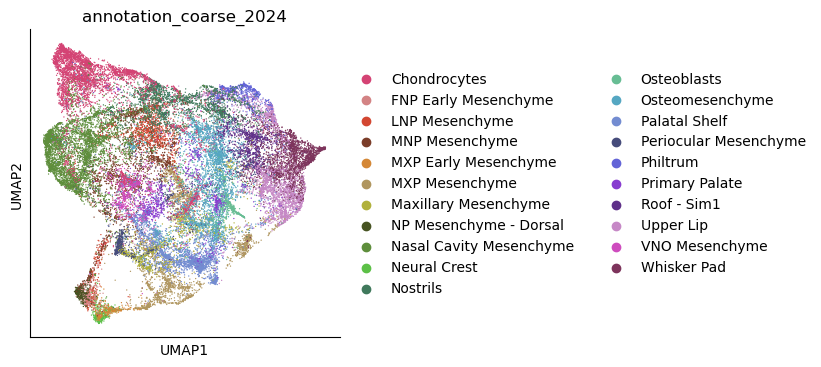

In [8]:
col_pal = ["#d44374",
"#d38384",
"#d34731",
"#7b3d29",
"#d48736",
"#b0965f",
"#b1b13b",
"#475322",
"#5e8e3c",
"#5cc047",
"#40795c",
"#67bd94",
"#55a7c2",
"#738cd1",
"#464c7b",
"#6364d7",
"#883cd0",
"#5f3089",
"#c688c6",
"#ce4cbe",
"#7d345c"]
sc.pl.umap(adata,color = 'annotation_coarse_2024',palette = col_pal)

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning:

No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored



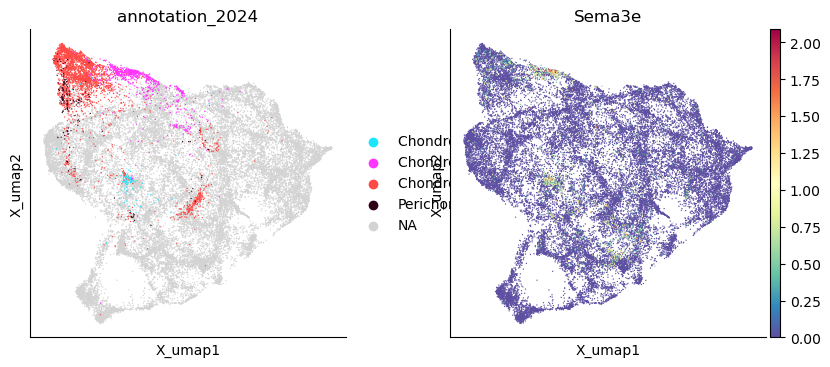

In [49]:
sc.pl.embedding(adata, color = ['annotation_2024','Sema3e'],
                basis = 'X_umap',
                groups = ['Chondro - VNO','Chondrocytes - Anterior Capsule','Chondrocytes - Septum/Capsule','Perichondrium'])

In [ ]:
adata = sc.read('anndata_objects/adata_palantir_cellrank_16_08_2024.h5ad')

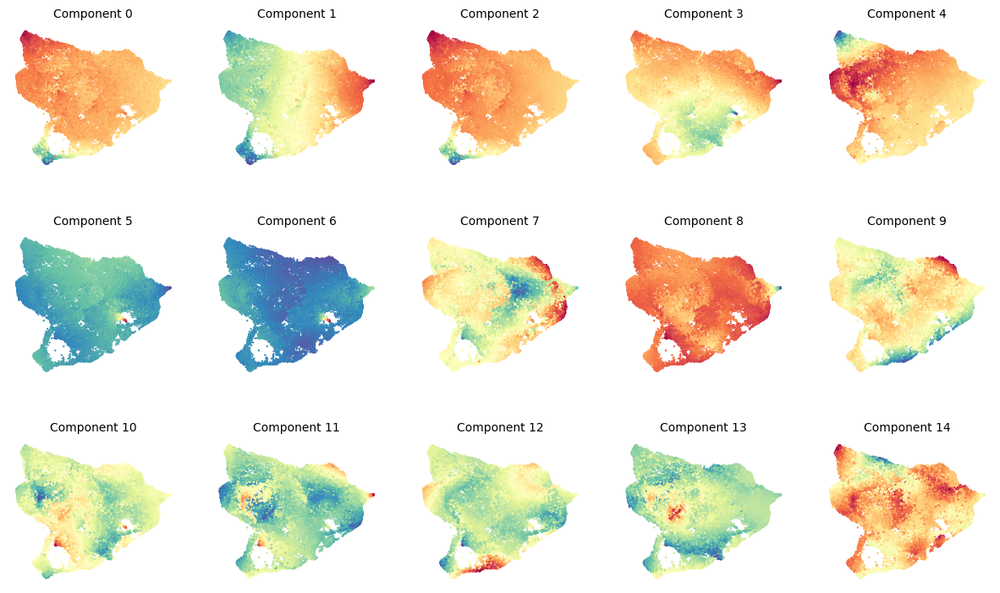

In [4]:
#redo pseudotime
import palantir
# Run diffusion maps
dm_res = palantir.utils.run_diffusion_maps(adata, pca_key = 'X_umap_features',knn = 10, n_components=15)
ms_data = palantir.utils.determine_multiscale_space(adata, n_eigs = 10)
#imputed_X = palantir.utils.run_magic_imputation(adata)
palantir.plot.plot_diffusion_components(adata,embedding_basis = 'X_umap')
plt.show()



In [5]:
# root_state = pd.Series(
#     ['root'],['AAGTTCCTCTCTTA.E8_10x21'],)
# palantir.plot.highlight_cells_on_umap(adata, root_state,embedding_basis = 'X_umap')
# plt.show()

# terminal_states = pd.Series(
#     ["1", "2", "3",'4','5','6','7'],
#     ['CGATGCGAGATTGAGT.14','CTCCAACAGCGAATGC.14','TACTGCCAGCTGCCTG.14','TATACCTCACTGTCGG.13','TTTCCTCCATGGGTCC.13','TCGACGGTCACTTCTA.14','ATGATCGCATCGCTCT.14'],
# )
# palantir.plot.highlight_cells_on_umap(adata, terminal_states,embedding_basis = 'X_umap')
# plt.show()

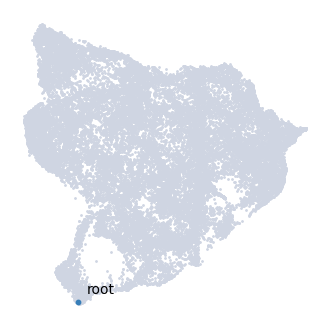

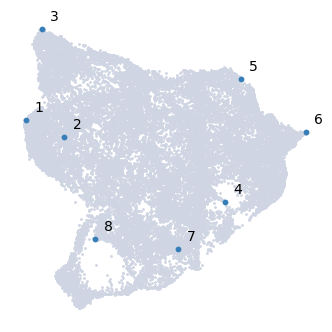

In [6]:
sc.tl.umap(adata, min_dist=0.1, negative_sample_rate=4, random_state=909)

root_state = pd.Series(
    ['root'],['CAGAAGCTGGTCAT.E8_10x23'],)
palantir.plot.highlight_cells_on_umap(adata, root_state,embedding_basis = 'X_umap')
plt.show()

terminal_states = pd.Series(
    ["1", "2", "3",'4','5','6','7','8'],
    ['TGGTACAGTACAATAG.14','ATGAAAGGTCTCTCTG.14','GGCTTTCGTATGAGAT.14','TCGACGGTCACTTCTA.14','TTGCATTGTTGTCATG.14','TAGGTTGTCCACTTTA.13','CTTGATTGTATTTCTC.14','ATGCATGTCATGACAC.14'],
)
palantir.plot.highlight_cells_on_umap(adata, terminal_states,embedding_basis = 'X_umap')
plt.show()

Sampling and flocking waypoints...
Time for determining waypoints: 1.7538740038871765 minutes
Determining pseudotime...
Shortest path distances using 15-nearest neighbor graph...
Time for shortest paths: 2.9050892988840737 minutes
Iteratively refining the pseudotime...
Correlation at iteration 1: 0.9987
Correlation at iteration 2: 1.0000
Entropy and branch probabilities...
Markov chain construction...
Computing fundamental matrix and absorption probabilities...
Project results to all cells...


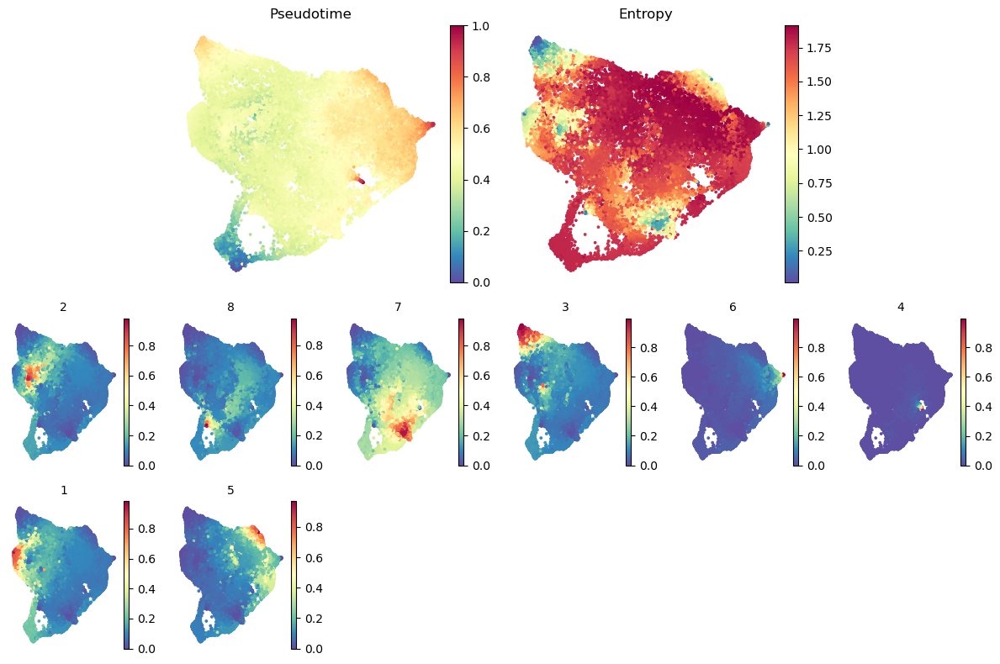

In [7]:
start_cell = 'CAGAAGCTGGTCAT.E8_10x23'
pr_res = palantir.core.run_palantir(
    adata, start_cell, num_waypoints=10000, knn = 15, terminal_states=terminal_states,use_early_cell_as_start=True,max_iterations=100,
)
palantir.plot.plot_palantir_results(adata, s=3,embedding_basis = 'X_umap')
plt.show()

In [13]:
masks = palantir.presults.select_branch_cells(adata,eps=0.00001,q=0.004)

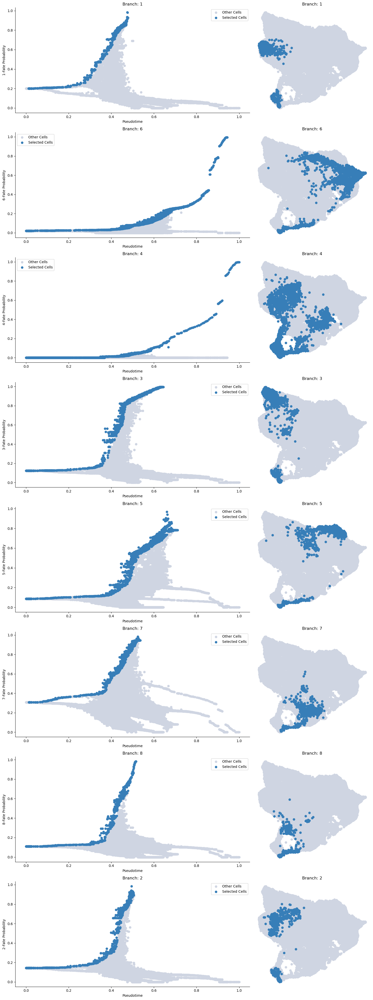

In [14]:
palantir.plot.plot_branch_selection(adata, embedding_basis='X_umap')
plt.show()

In [4]:
ps_fwd = cr.kernels.PseudotimeKernel(adata, time_key="palantir_pseudotime", backward=False)
ps_fwd.compute_transition_matrix(threshold_scheme = 'hard',
                                 frac_to_keep = 0.3,
                                )

100%|██████████| 33371/33371 [00:06<00:00, 5453.36cell/s]


PseudotimeKernel[n=33371, dnorm=False, scheme='hard', frac_to_keep=0.3]

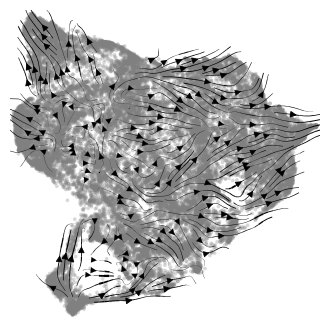

In [5]:
ps_fwd.plot_projection(basis='X_umap')


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scvelo/plotting/scatter.py:655: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scvelo/plotting/scatter.py:693: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scvelo/plotting/utils.py:1388: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=bg_size, marker=".", c=bg_color, zorder=zord - 2, **kwargs)
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scvelo/plotting/utils.py:1389: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=gp_size, marker=".", c=gp_color, zorder=zord - 1, **kwargs)


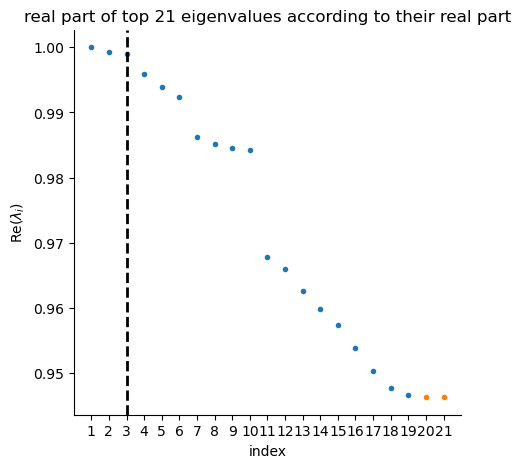

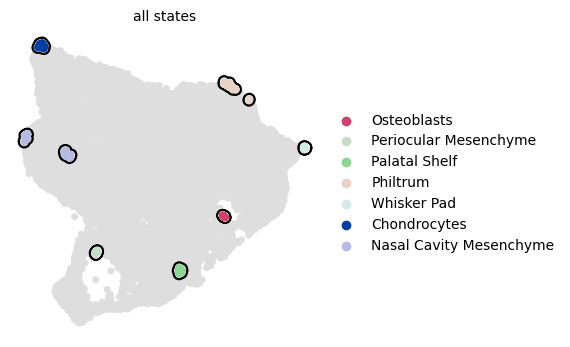

In [6]:
g_ps_fwd = cr.estimators.GPCCA(ps_fwd)
g_ps_fwd.compute_schur(n_components=20)
g_ps_fwd.plot_spectrum(real_only=True)
g_ps_fwd.compute_macrostates(n_states=7,cluster_key="annotation_coarse_2024")
g_ps_fwd.plot_macrostates(which="all", legend_loc="right", s=100,basis = 'X_umap')

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scvelo/plotting/scatter.py:655: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scvelo/plotting/scatter.py:693: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scvelo/plotting/utils.py:1388: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=bg_size, marker=".", c=bg_color, zorder=zord - 2, **kwargs)
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scvelo/plotting/utils.py:1389: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=gp_size, marker=".", c=gp_color, zorder=zord - 1, **kwargs)


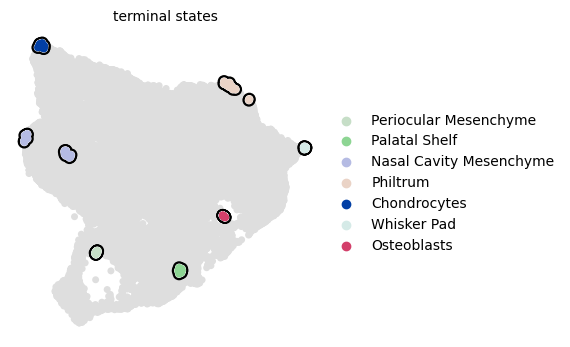

In [7]:
g_ps_fwd.predict_terminal_states(method='top_n',n_states=7)
g_ps_fwd.plot_macrostates(which="terminal", legend_loc="right", s=100,basis = 'X_umap')

100%|██████████| 7/7 [00:00<00:00, 15.01/s]
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0


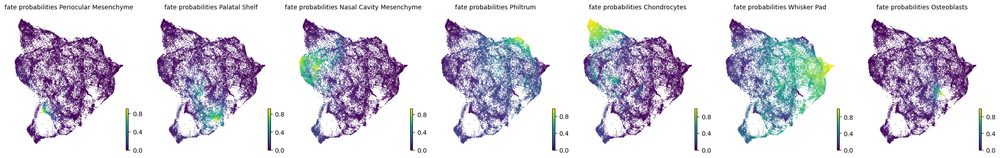

In [8]:
g_ps_fwd.compute_fate_probabilities()
g_ps_fwd.plot_fate_probabilities(same_plot=False,basis = 'X_umap')

In [9]:
model = cr.models.GAMR(adata, n_knots=6, smoothing_penalty=10.0)

In [12]:
lineages = ['Whisker Pad','Osteoblasts','Chondrocytes','Nasal Cavity Mesenchyme','Periocular Mesenchyme','Palatal Shelf','Philtrum']
for lineage in lineages:
    g_ps_fwd.compute_lineage_drivers(lineages=lineage).to_csv('figures/trajectory_figures_cellrank/'+lineage+'.csv')


In [10]:
lineage = 'Whisker Pad'
g_ps_fwd.compute_lineage_drivers(lineages=lineage)

,Whisker Pad_corr,Whisker Pad_pval,Whisker Pad_qval,Whisker Pad_ci_low,Whisker Pad_ci_high
Index,,,,,
Lef1,0.672766,0.0,0.0,0.666850,0.678597
Twist2,0.571447,0.0,0.0,0.564177,0.578629
Cxcl14,0.563201,0.0,0.0,0.555831,0.570483
Bcl11b,0.547744,0.0,0.0,0.540189,0.555210
Apcdd1,0.478936,0.0,0.0,0.470625,0.487162
...,...,...,...,...,...
Foxc1,-0.422789,0.0,0.0,-0.431561,-0.413938
Col9a1,-0.428071,0.0,0.0,-0.436794,-0.419267
Col2a1,-0.432269,0.0,0.0,-0.440953,-0.423504


100%|██████████| 102/102 [00:13<00:00,  7.43gene/s]


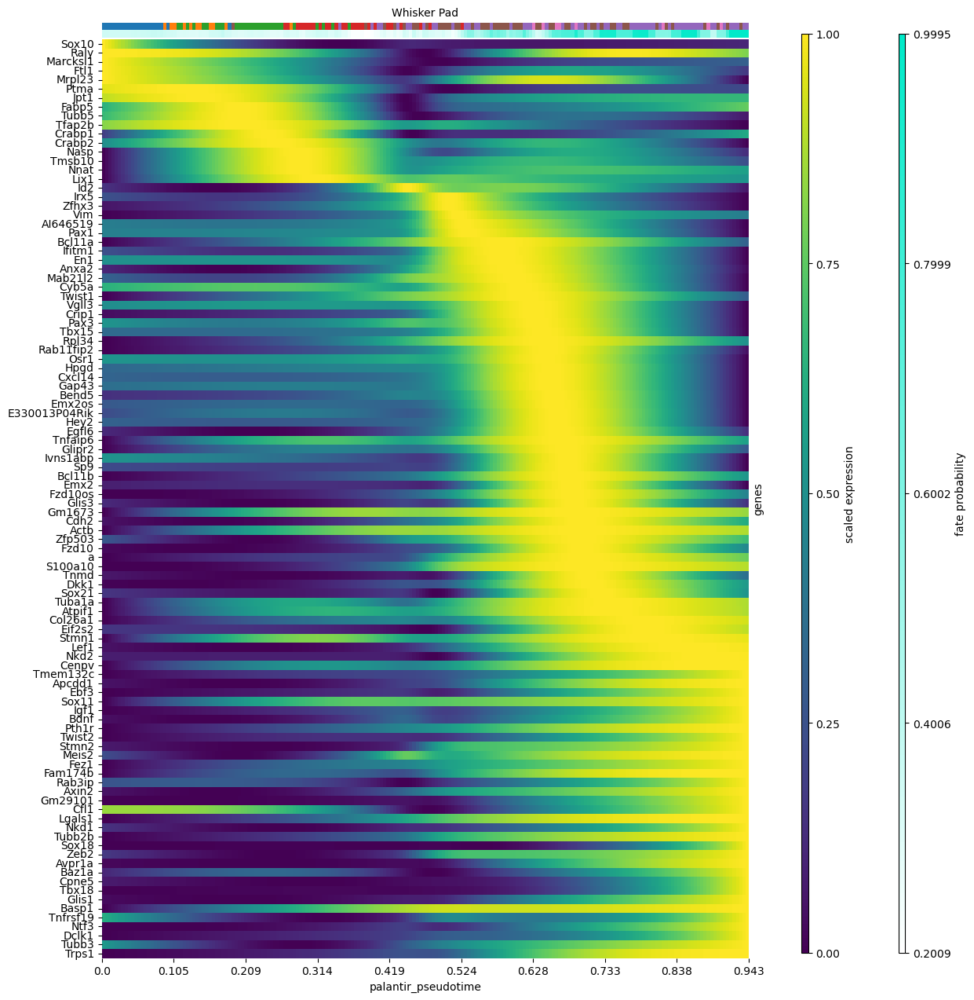

In [18]:
# compute putative drivers for the Beta trajectory
lineage = 'Whisker Pad'
beta_drivers = g_ps_fwd.compute_lineage_drivers(lineages=lineage)

# plot heatmap
cr.pl.heatmap(
    adata,
    model=model,  # use the model from before
    lineages=lineage,
    cluster_key="stage",
    show_fate_probabilities=True,
    genes=['Sox10','Tfap2b']+list(beta_drivers.head(100).index),
    time_key="palantir_pseudotime",
    figsize=(12, 15),
    show_all_genes=True,
    scale=True,
    #adata_key = 'X',
    #use_raw = False,
)

In [29]:
adata.X = csr_matrix(adata.X)
adata.write('anndata_objects/adata_palantir_cellrank_16_08_2024.h5ad')

In [2]:
adata = sc.read('anndata_objects/adata_palantir_cellrank_16_08_2024.h5ad')

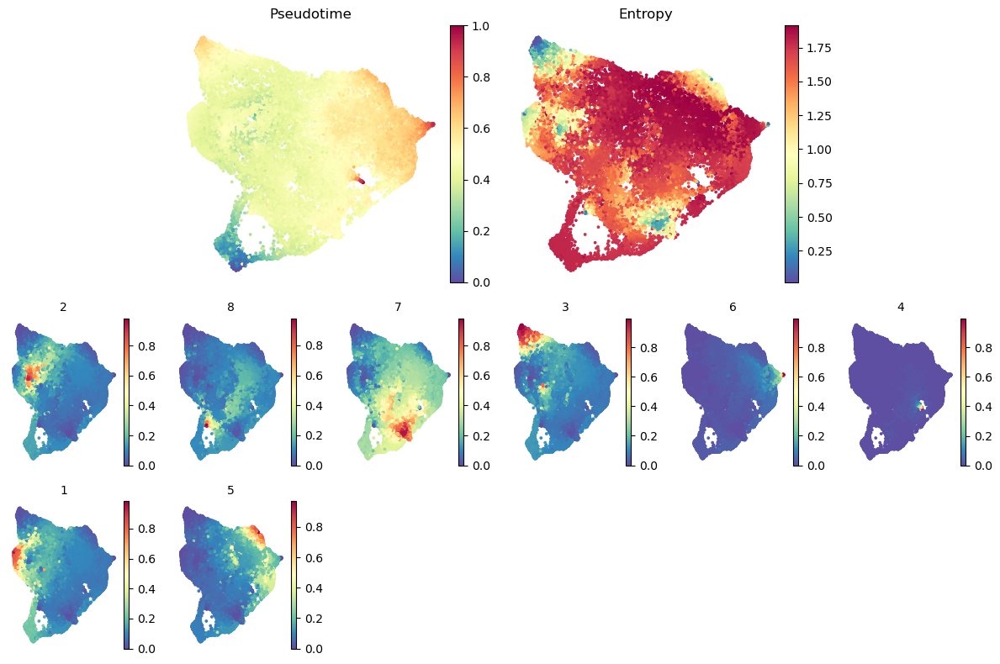

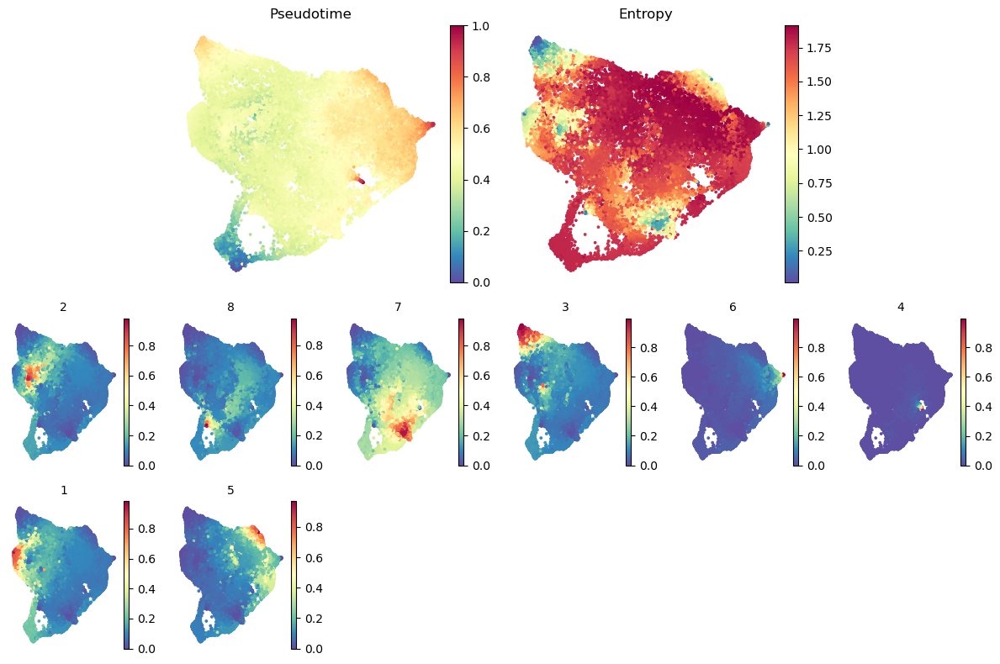

In [3]:
palantir.plot.plot_palantir_results(adata, s=3,embedding_basis = 'X_umap')

In [17]:
for column in adata.obsm['palantir_fate_probabilities']:
    adata.obs['palantir_fate_probabilities_'+column] = list(adata.obsm['palantir_fate_probabilities'][column])

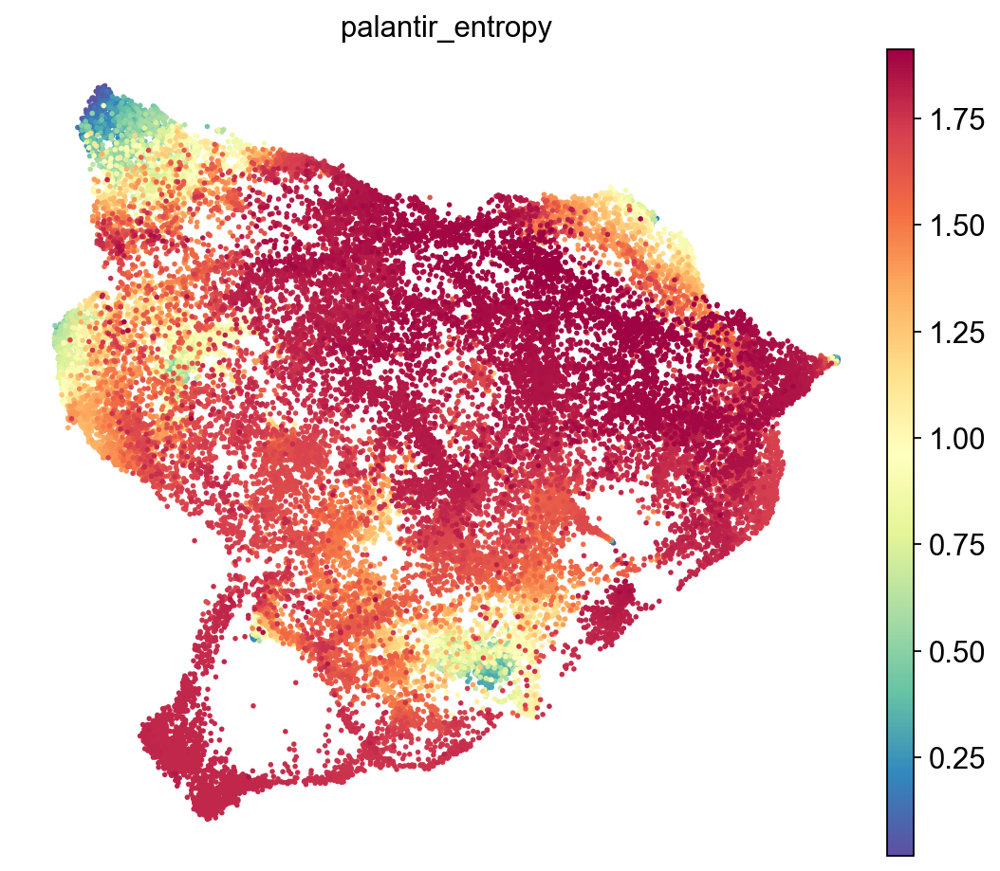

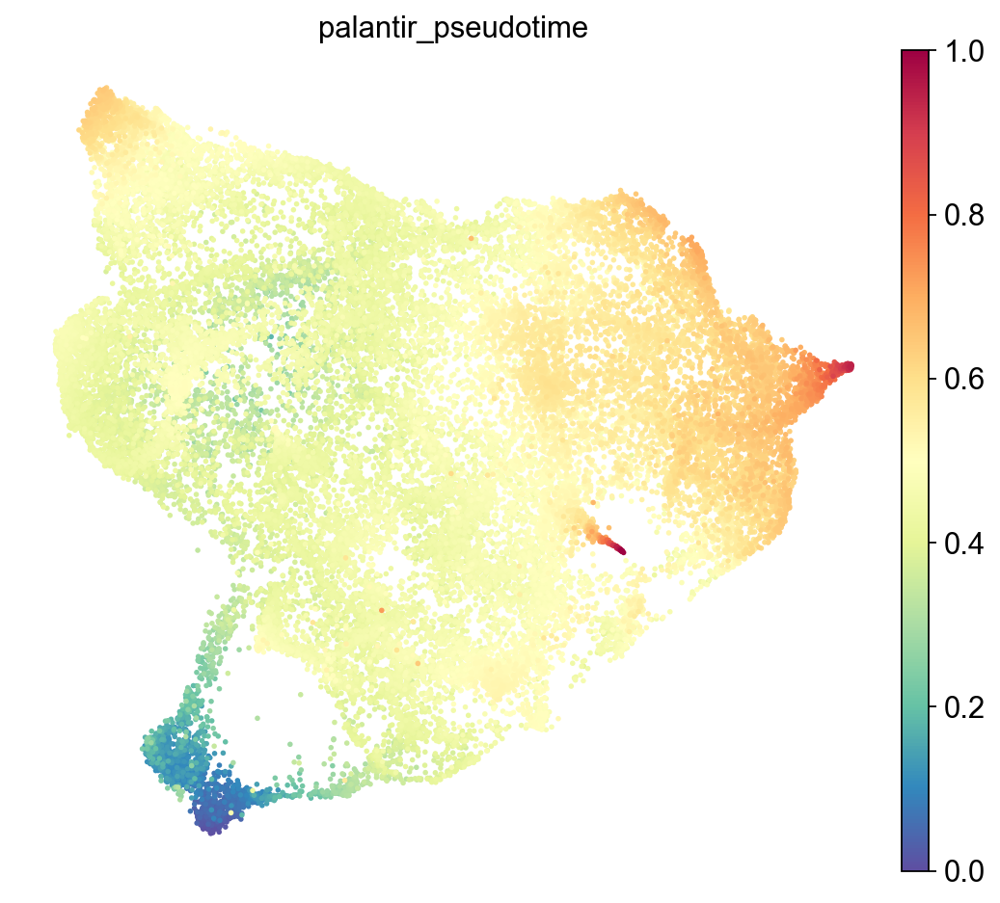

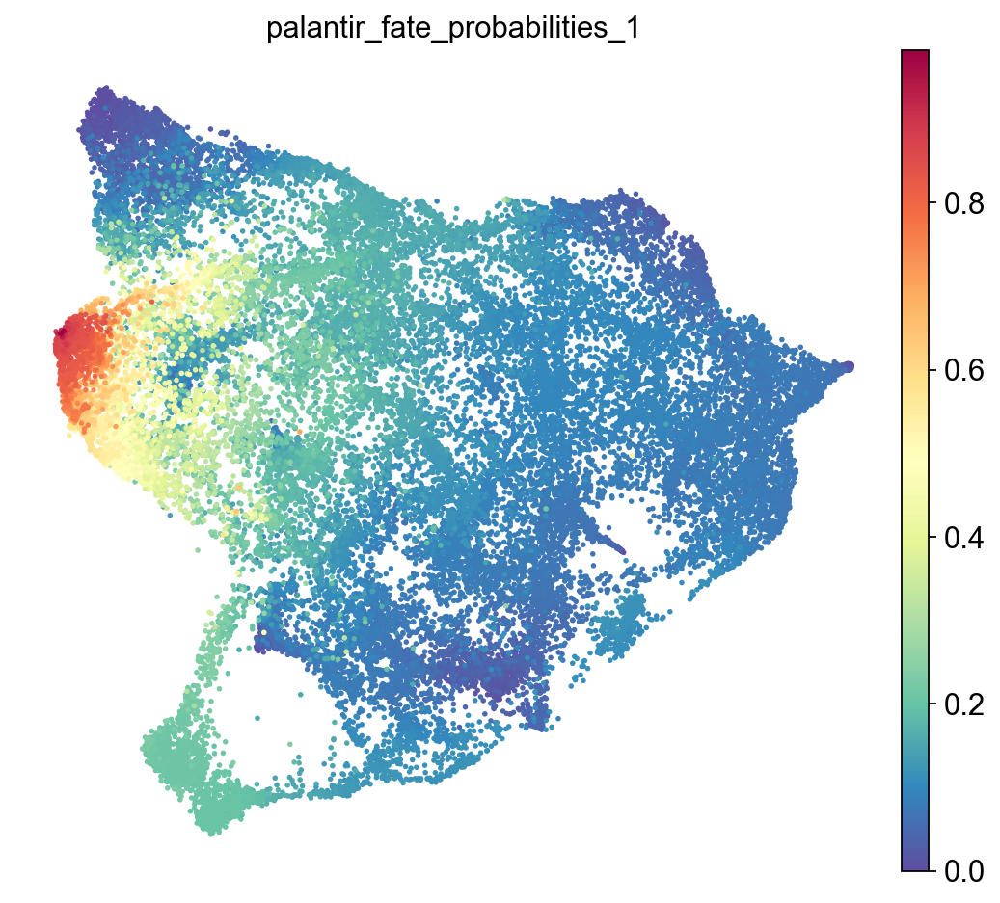

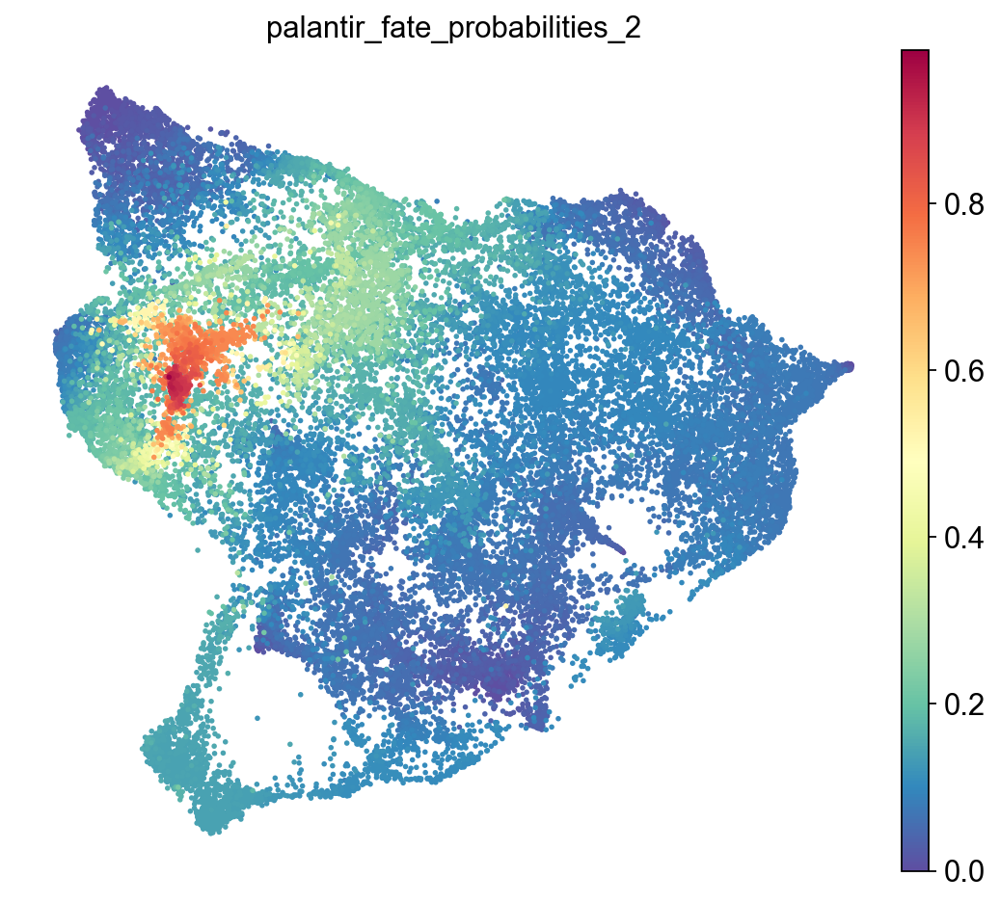

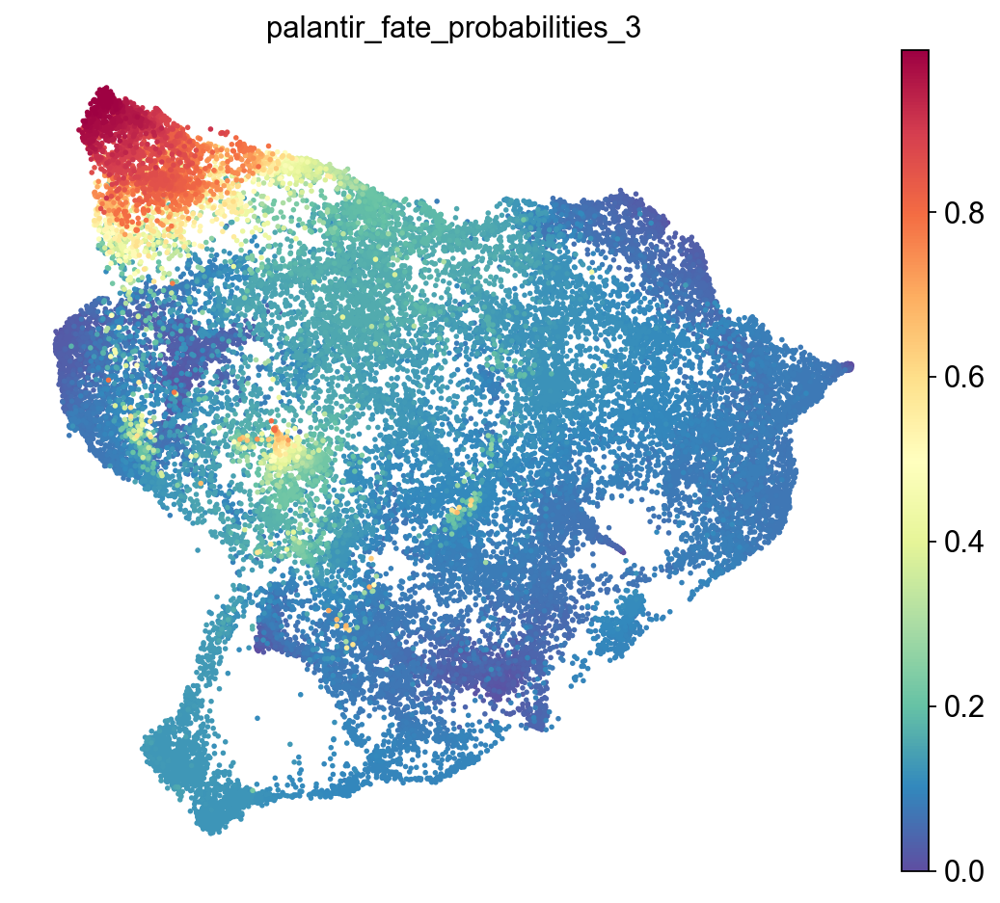

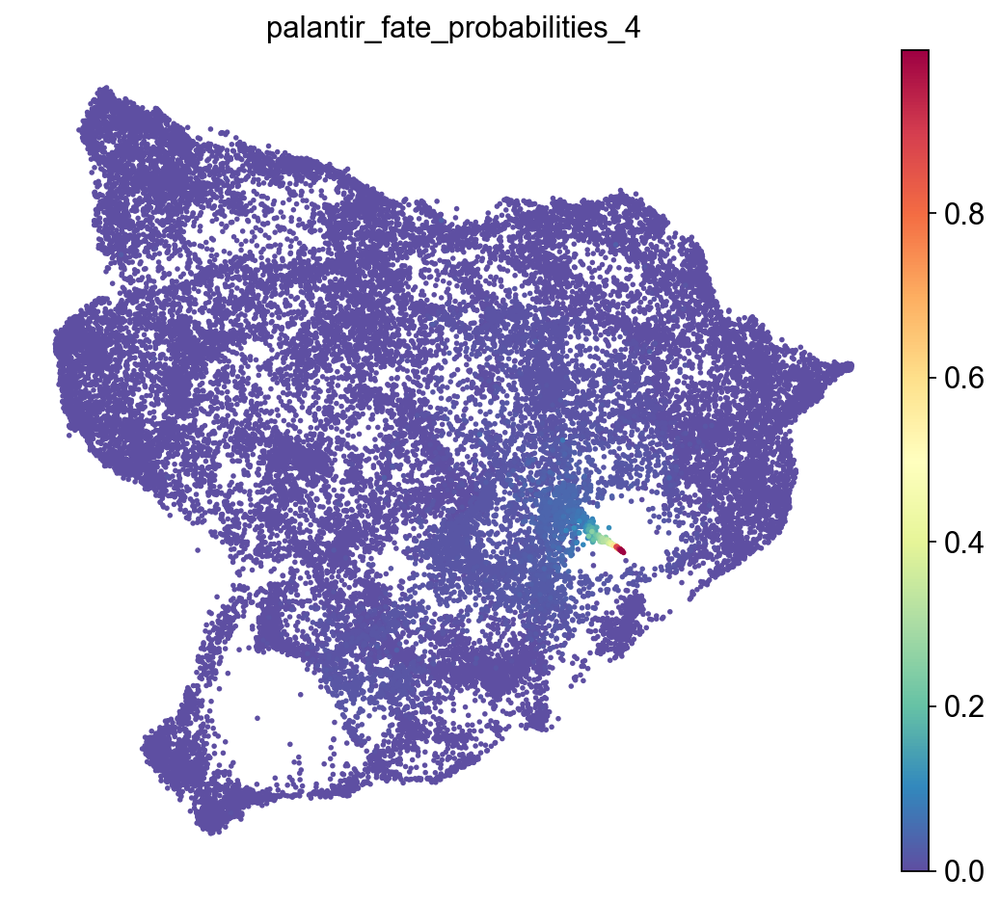

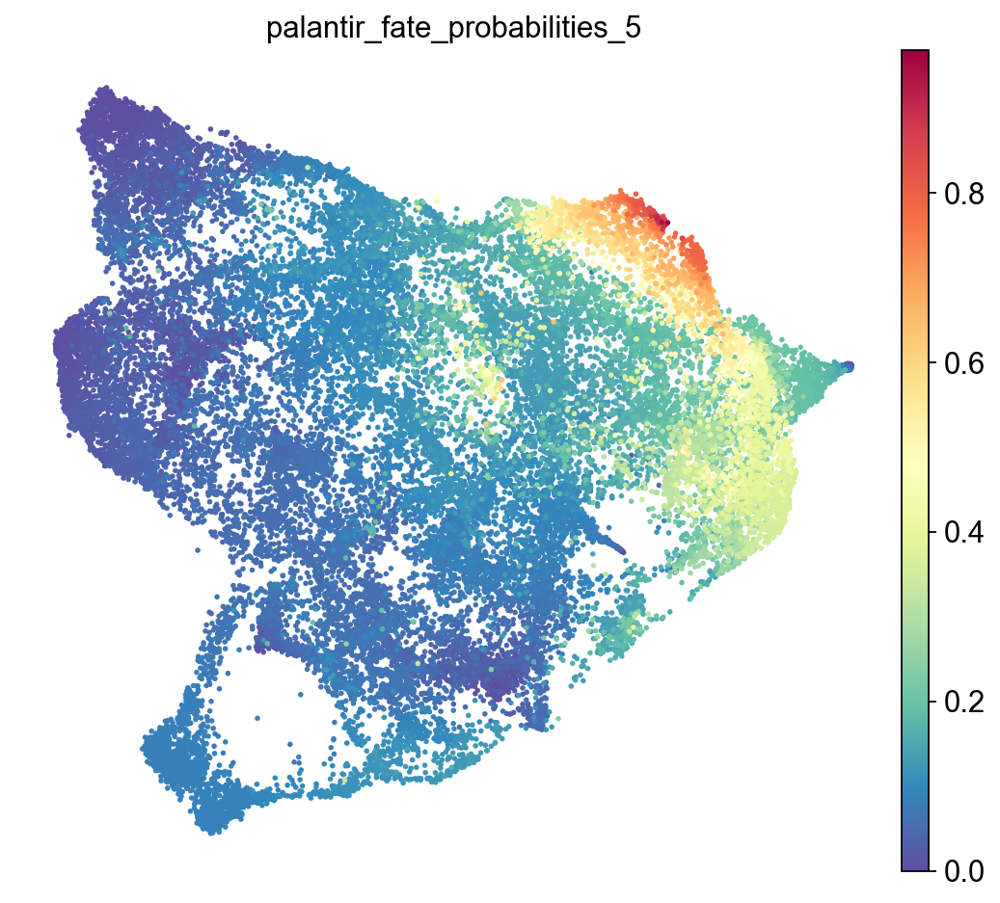

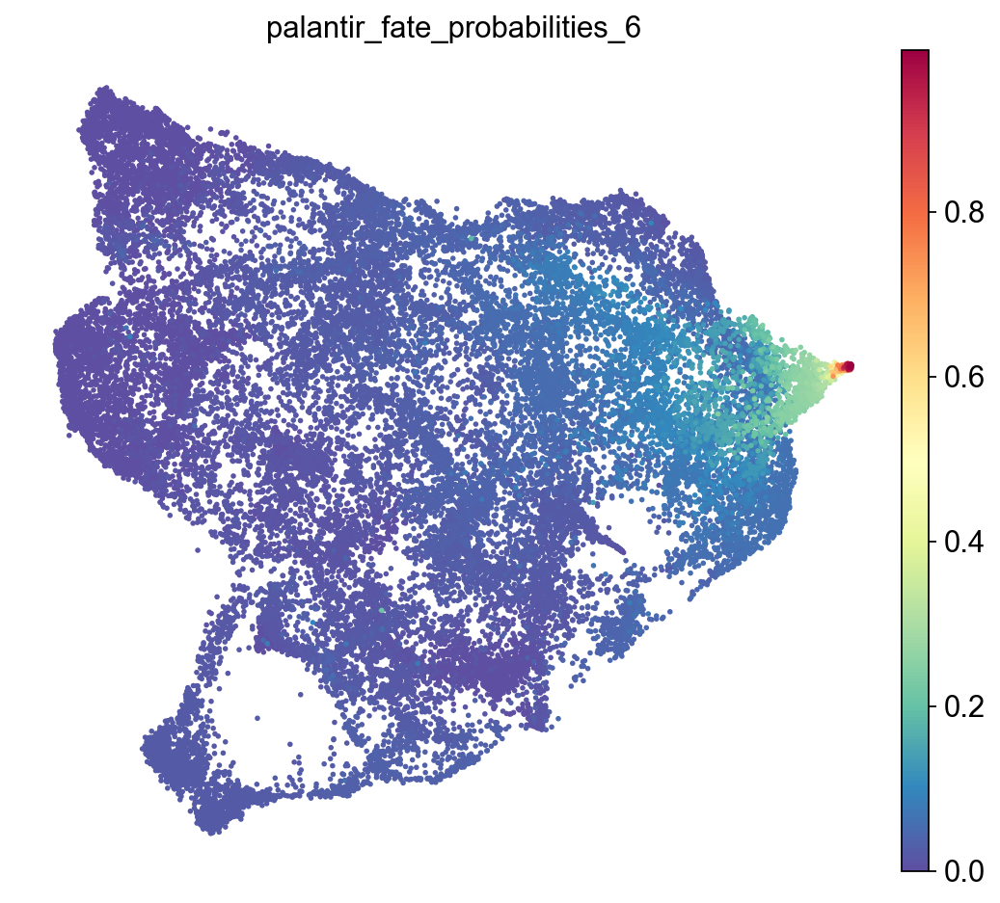

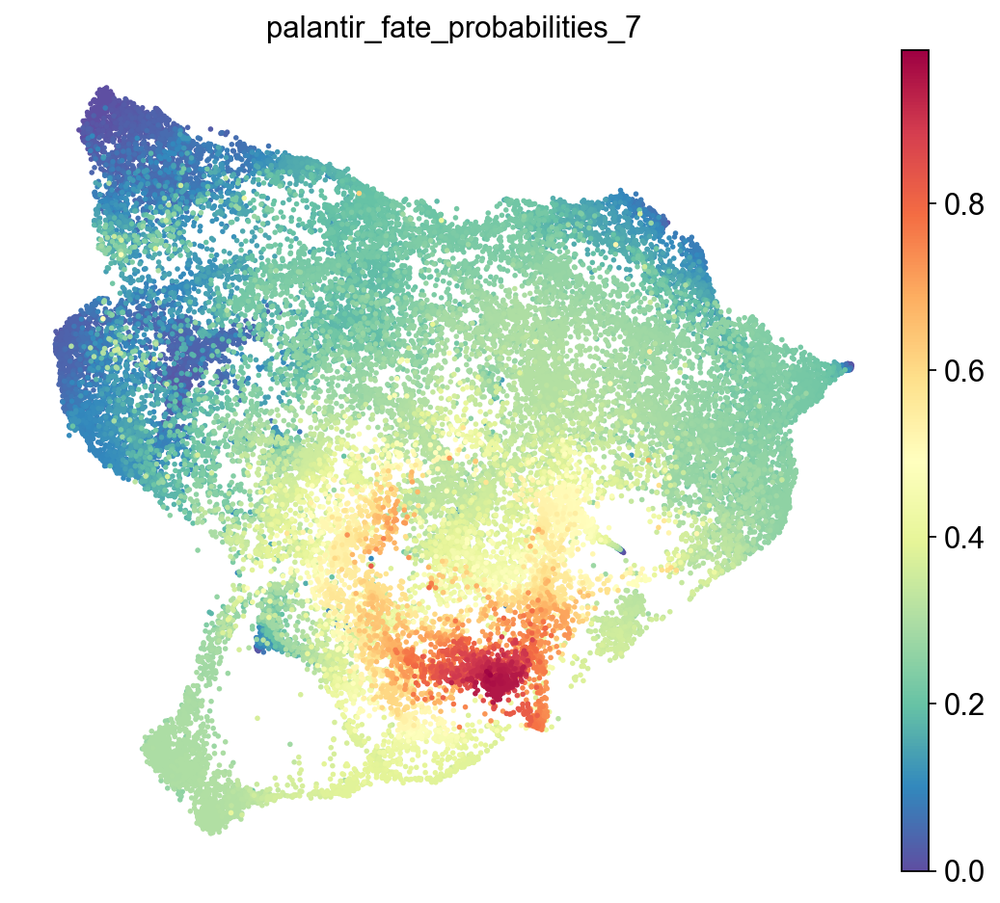

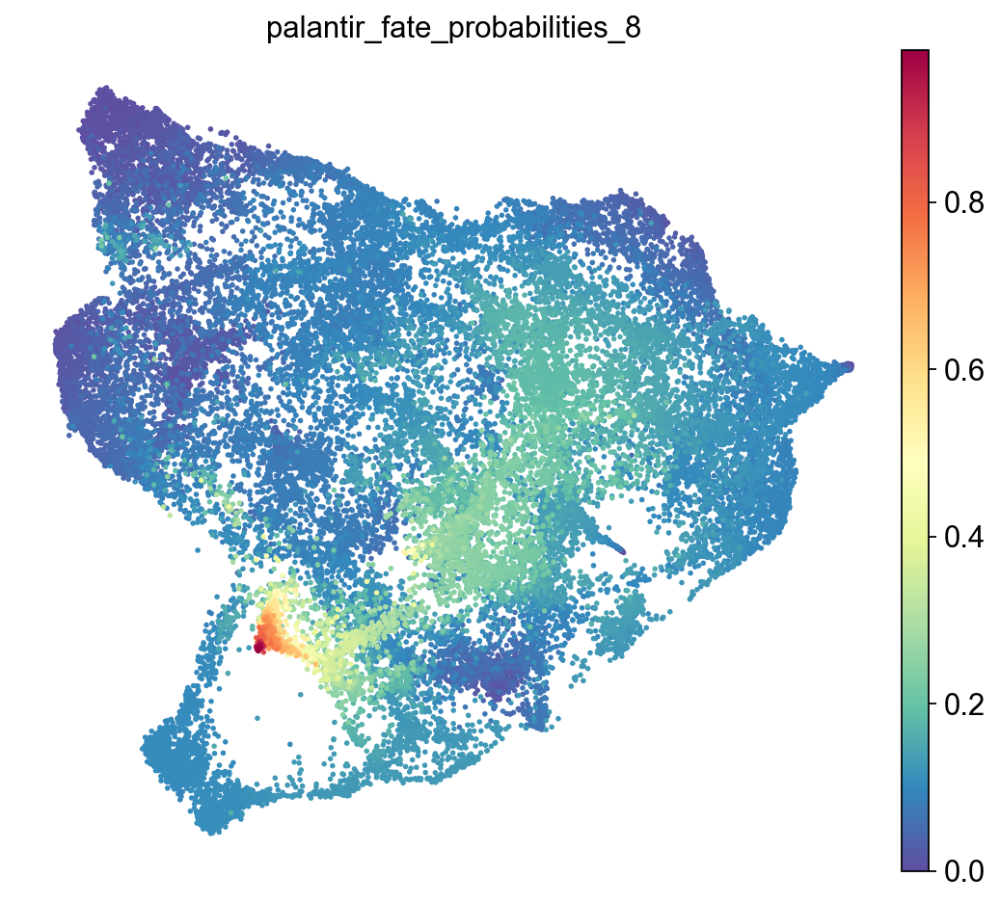

In [19]:
from pathlib import Path
sc.set_figure_params(figsize=[8,7],vector_friendly = True, dpi_save = 300)
sc._settings.ScanpyConfig.figdir=Path('./figures/trajectory_figures_cellrank/') #set figdir

annotation_list = ['palantir_entropy','palantir_pseudotime',
                   'palantir_fate_probabilities_1','palantir_fate_probabilities_2','palantir_fate_probabilities_3','palantir_fate_probabilities_4','palantir_fate_probabilities_5','palantir_fate_probabilities_6','palantir_fate_probabilities_7','palantir_fate_probabilities_8',]
for obs in annotation_list:
    sc.pl.umap(adata, frameon=False, color = obs,size = 25,ncols=1,save = '_'+obs+'_embedding.svg')


100%|██████████| 291/291 [01:08<00:00,  4.24gene/s]
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0


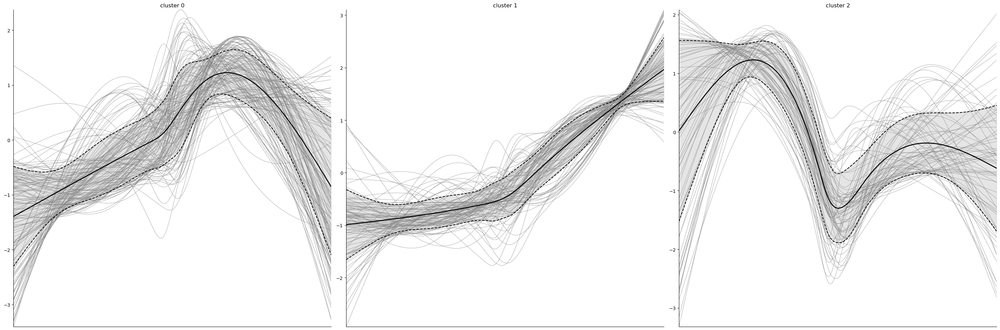

In [172]:
cr.pl.cluster_trends(
    adata,
    model=model,  # use the model from before
    lineage=lineage,
    genes=list(beta_drivers[beta_drivers["Whisker Pad_corr"]>0.15].index),
    time_key="palantir_pseudotime",
    weight_threshold=(1e-3, 1e-3),
    n_jobs=1,
    random_state=0,
    clustering_kwargs={"resolution": 0.2, "random_state": 0},
    neighbors_kwargs={"random_state": 0},
    recompute=True,
)

In [174]:
gdata = adata.uns['lineage_Whisker Pad_trend'].copy()

In [175]:
len(list(gdata[gdata.obs['clusters']=='1']))

94

In [176]:
print('[%s]' % '\n'.join(map(str, list(gdata[gdata.obs['clusters']=='2'].obs.index))))

[Fabp5
Tubb5
Crabp1
Tmsb10
Lix1
Raly
Cfl1
Marcksl1
Nnat
Ftl1
Nasp
Jpt1
Crabp2
Ptma
Prdx2
Gapdh
Tead2
Dnajc9
Macroh2a2
Ybx1
Ppia
Srsf2
Actg1
Srsf3
Hnrnpab
Abracl
Ezh2
Tcf3
H2az1
Tuba1b
Limd2
Ran
Hmgb3
Fscn1
Dnaja1
Psmc4
Hmgn1
Pdap1
Ahcy
Cox5a
Hnrnpa1
Pinx1
Tbcb
Atp5b
Carhsp1
Ndufaf2
Hsp90aa1
Ranbp1
Set
Idi1
Mat2a
Gpx1
Prex2
Fdps
Sae1
Gcat
Hnrnpdl
Eif5
Psmb3
Uhrf1
Acat2
Tlnrd1
Rrm2
Rps27l
Nedd8
Cdk4
Anp32a
Rbm3
Sqle
Pclaf
Mcm7]


In [177]:
import gseapy as gp

100%|██████████| 33371/33371 [00:05<00:00, 6181.12cell/s]


/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scvelo/plotting/scatter.py:655: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scvelo/plotting/scatter.py:693: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scvelo/plotting/utils.py:1388: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=bg_size, marker=".", c=bg_color, zorder=zord - 2, **kwargs)
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scvelo/plotting/utils.py:1389: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=gp_size, marker=".", c=gp_color, zorder=zord - 1, **kwargs)


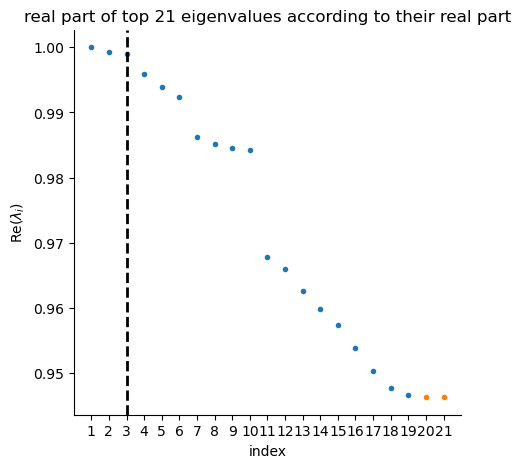

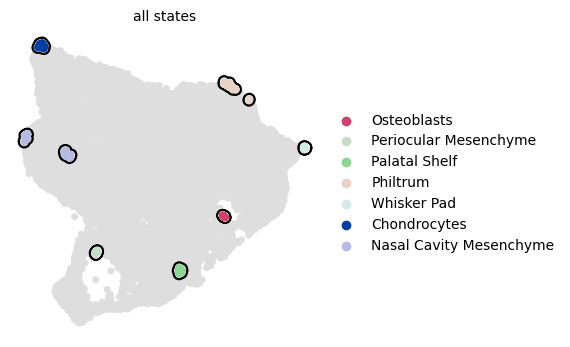

/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scvelo/plotting/scatter.py:655: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scvelo/plotting/scatter.py:693: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scvelo/plotting/utils.py:1388: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=bg_size, marker=".", c=bg_color, zorder=zord - 2, **kwargs)
/home/jupyter-seton/micromamba/envs/cellrank/lib/python3.11/site-packages/scvelo/plotting/utils.py:1389: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x, y, s=gp_size, marker=".", c=gp_color, zorder=zord - 1, **kwargs)


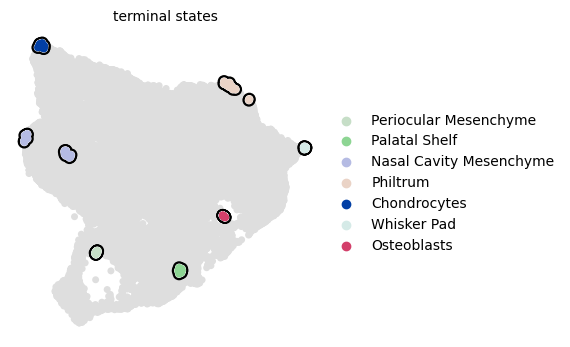

100%|██████████| 7/7 [00:00<00:00, 14.57/s]
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0


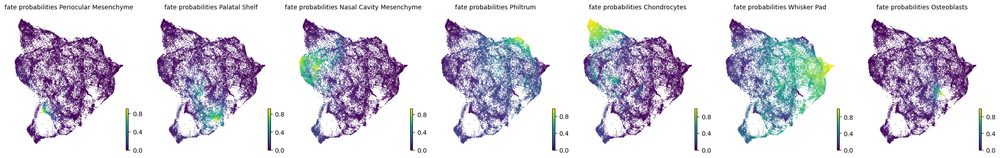

In [4]:
ps_fwd = cr.kernels.PseudotimeKernel(adata, time_key="palantir_pseudotime", backward=False)
ps_fwd.compute_transition_matrix(threshold_scheme = 'hard',
                                 frac_to_keep = 0.3,
                                )
g_ps_fwd = cr.estimators.GPCCA(ps_fwd)
g_ps_fwd.compute_schur(n_components=20)
g_ps_fwd.plot_spectrum(real_only=True)
g_ps_fwd.compute_macrostates(n_states=7,cluster_key="annotation_coarse_2024")
g_ps_fwd.plot_macrostates(which="all", legend_loc="right", s=100,basis = 'X_umap')

g_ps_fwd.predict_terminal_states(method='top_n',n_states=7)
g_ps_fwd.plot_macrostates(which="terminal", legend_loc="right", s=100,basis = 'X_umap')

g_ps_fwd.compute_fate_probabilities()
g_ps_fwd.plot_fate_probabilities(same_plot=False,basis = 'X_umap')

In [228]:
#print('[%s]' % '\n'.join(map(str, list(lineage_dict['Periocular Mesenchyme']['gene_trends'][lineage_dict['Periocular Mesenchyme']['gene_trends'].obs['clusters']=='0'].obs.index))))

In [257]:
#list(-np.log10(lineage_dict['Periocular Mesenchyme']['enrich_output']['0'].res2d.sort_values(by=['Adjusted P-value'])['Adjusted P-value']))

[9.574404656891645,
 9.574404656891645,
 9.50267936623324,
 9.374752509636945,
 9.364442694685543,
 9.341894521623503,
 8.500392514012695,
 8.474490547279165,
 7.881961235501542,
 7.78231214278798,
 6.565573800426978,
 6.565573800426978,
 6.231751245010748,
 6.182561309492906,
 5.824384340732882,
 5.665700126546507,
 5.665700126546507,
 5.55808424993598,
 5.55808424993598,
 5.285647183483407,
 5.088897484601168,
 5.014146123539931,
 4.962107055422671,
 4.953485575141541,
 4.953485575141541,
 4.953485575141541,
 4.953485575141541,
 4.931034325882505,
 4.8922786185079685,
 4.815917452018397,
 4.815917452018397,
 4.79058624116461,
 4.7326604215567425,
 4.577099689276439,
 4.517948564264705,
 4.517948564264705,
 4.505831076666962,
 4.505831076666962,
 4.483316665964194,
 4.45257283215541,
 4.331017535546142,
 4.0889158300676085,
 4.0417830894187725,
 4.01932593063818,
 4.0099815989366805,
 3.932196207624744,
 3.8958845754861087,
 3.803613731478392,
 3.7658133764506383,
 3.6377409617313985,

100%|██████████| 225/225 [00:47<00:00,  4.69gene/s]
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
Abort(59) on node 0 (rank 0 in comm 0): application called MPI_Abort(MPI_COMM_WORLD, 59) - process 0
100%|██████████| 174/174 [00:38<00:00,  4.56gene/s]
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/

{'Periocular Mesenchyme': {'lineage_drivers':         Periocular Mesenchyme_corr  Periocular Mesenchyme_pval  \
  Index                                                            
  Foxp2                     0.393681                0.000000e+00   
  Foxl2                     0.368762                0.000000e+00   
  Tmeff2                    0.333008                0.000000e+00   
  Hic1                      0.323367                0.000000e+00   
  Creb5                     0.303678                0.000000e+00   
  ...                            ...                         ...   
  Wnt5a                    -0.168087               5.651186e-211   
  Lef1                     -0.174416               2.471328e-227   
  Trps1                    -0.184822               1.176800e-255   
  Bcl11b                   -0.189610               2.728018e-269   
  Msx1                     -0.224219                0.000000e+00   
  
          Periocular Mesenchyme_qval  Periocular Mesenchyme_ci_low  \

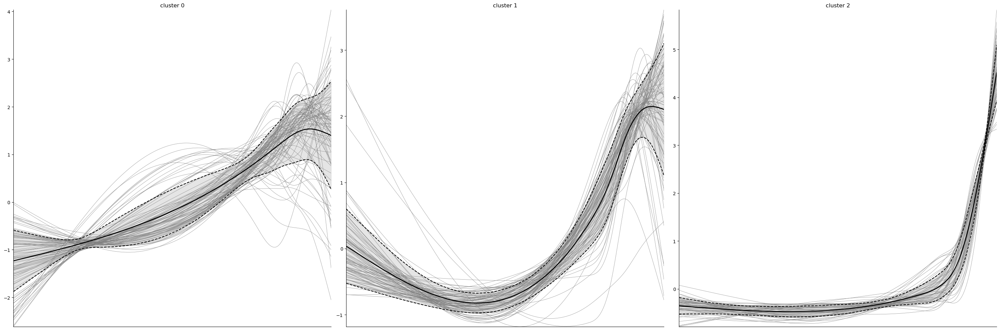

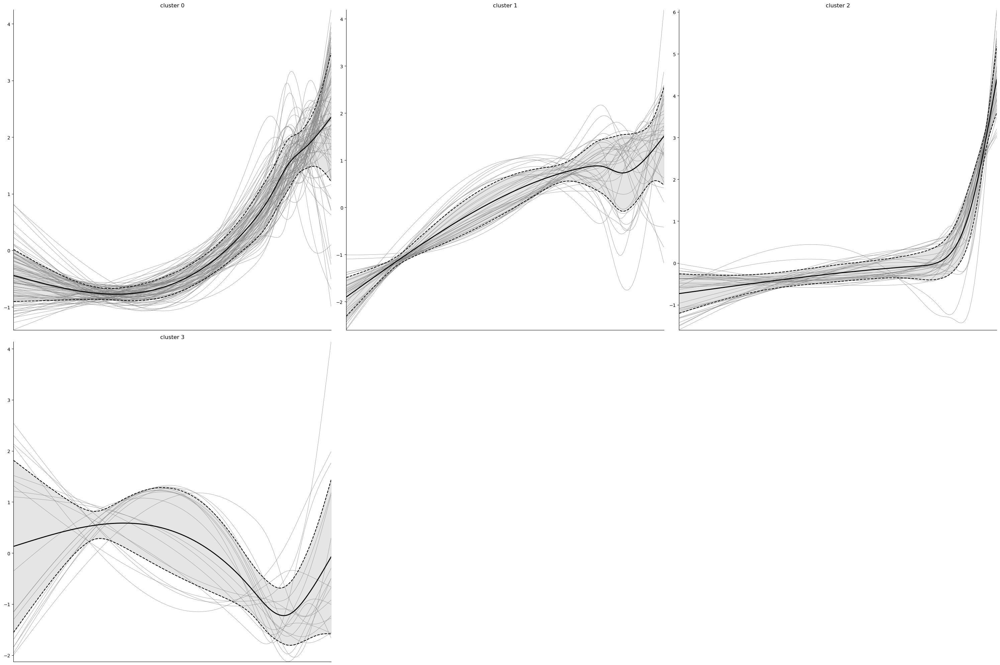

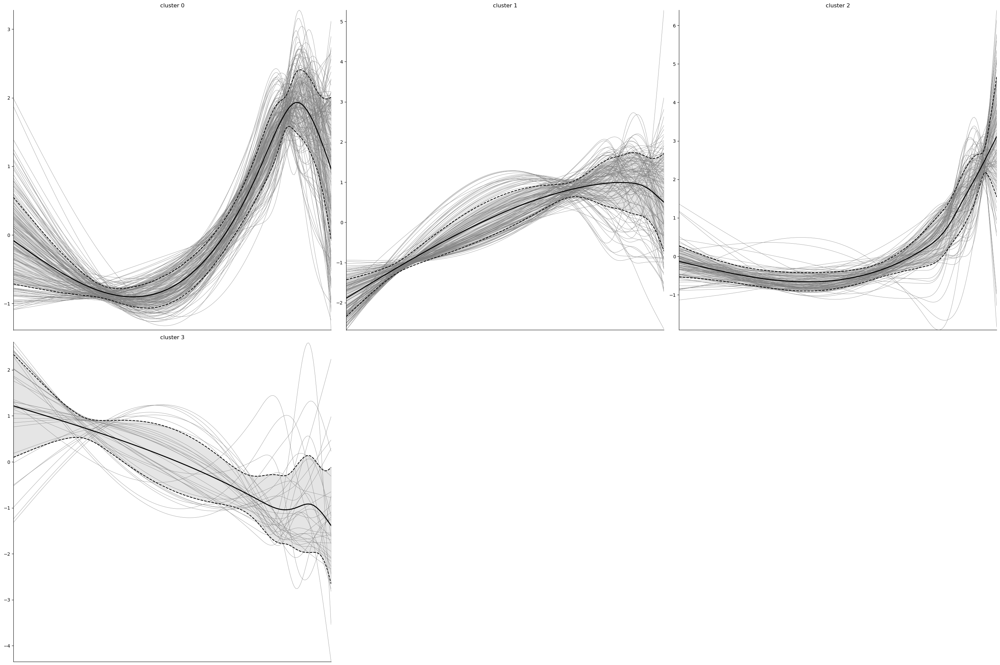

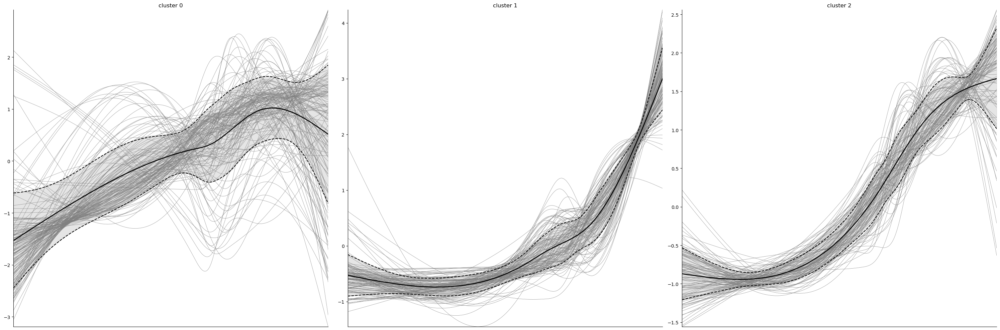

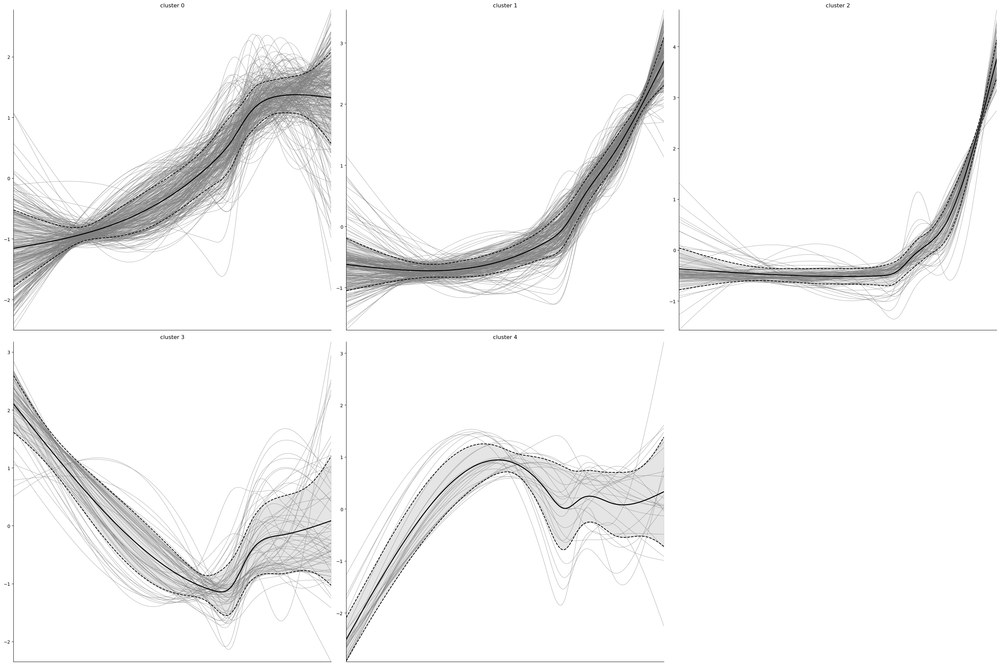

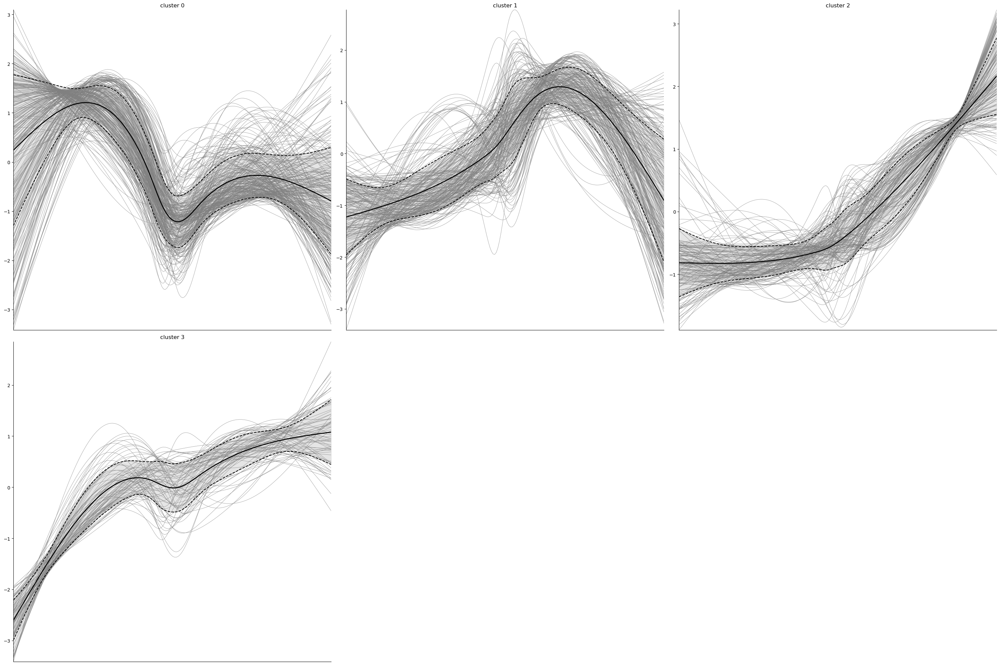

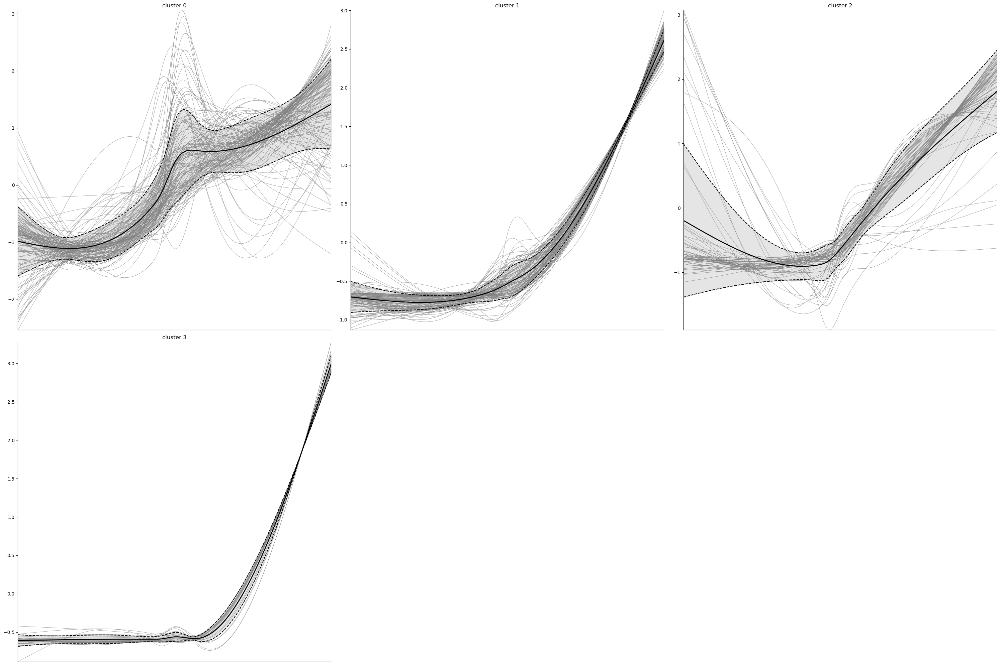

In [34]:
lineage_driver_cutoff = 0.1
background_genes_file = 'gsea_test/all_genes.txt'
gene_set_file = 'gsea_test/geneontology_Biological_Process_noRedundant.gmt'

import gseapy as gp

lineage_list = list(adata.obs['term_states_fwd'].cat.categories)
lineage_dict = {}
model = cr.models.GAMR(adata, n_knots=6, smoothing_penalty=10.0)

#load background genes
with open(background_genes_file) as file:
    background_genes = [line.rstrip() for line in file]

#messy nested for loops
for lineage in lineage_list:
    lineage_dict[lineage] = {} #create a dict entry for each lineage
    lineage_dict[lineage]['lineage_drivers'] = g_ps_fwd.compute_lineage_drivers(lineages=lineage) #add lineage driver list
    driver_genes = lineage_dict[lineage]['lineage_drivers'] #add variable for readability
    driver_genes = list(driver_genes[driver_genes[lineage+"_corr"]>lineage_driver_cutoff].index) #keep only ones with certain correlation cutoff
    lineage_dict[lineage]['cluster_trend_plot'] = cr.pl.cluster_trends(adata,
                                                                       model=model,  # use the model from before
                                                                       lineage=lineage,
                                                                       genes=driver_genes,
                                                                       time_key="palantir_pseudotime",
                                                                       weight_threshold=(1e-3, 1e-3),
                                                                       n_jobs=1,
                                                                       random_state=0,
                                                                       clustering_kwargs={"resolution": 0.2, "random_state": 0},
                                                                       neighbors_kwargs={"random_state": 0},
                                                                       recompute=True,
                                                                      )
    lineage_dict[lineage]['gene_trends'] = adata.uns['lineage_'+lineage+'_trend'].copy()
    gdata = lineage_dict[lineage]['gene_trends']
    enrich_output = {}
    for cluster in set(gdata.obs['clusters']):
        gene_list = list(gdata[gdata.obs['clusters']==cluster].obs.index)
        enrich_output[cluster] = gp.enrich(gene_list = gene_list ,
                                           gene_sets = gene_set_file,
                                           #description='Cluster_'+i,
                                           background = background_genes,
                                           outdir = 'gsea_plots/'+lineage+'_Cluster_'+cluster,
                                           cutoff = 0.5, 
                                          )
    lineage_dict[lineage]['enrich_output'] = enrich_output
lineage_dict

In [32]:
import os
os.environ["PATH"] += os.pathsep + "/home/jupyter-seton/micromamba/envs/cellrank/bin"

for lineage in lineage_dict:
    dotplot_df = create_dotplot_df(lineage_dict = lineage_dict,
                                   lineage = lineage,
                                  )
    plotly_dotplot(dotplot_df = dotplot_df,
                   title = "Enriched GO Terms <br><sup>"+lineage+"</sup>",
                   save_loc = "figures/gsea_plots/"+lineage+"_gene_clusters_dotplot.svg",
                  )

In [36]:
#######################################################
#######################################################
#######################################################
#######################################################
#######################################################
#######################################################
#######################################################

In [37]:
gdata[gdata.obs["clusters"] == "3"].obs.head(8).index

Index(['Cxcl14', 'Emx2', 'Hey2', 'Twist1', 'Gap43', 'Emx2os', 'Mab21l2',
       'Irx5'],
      dtype='object')

In [ ]:
# compute putative drivers for the Beta trajectory
lineage = 'Periocular Mesenchyme'
beta_drivers = g_ps_fwd.compute_lineage_drivers(lineages=lineage)

# plot heatmap
cr.pl.heatmap(
    adata,
    model=model,  # use the model from before
    lineages=lineage,
    cluster_key="stage",
    show_fate_probabilities=True,
    genes=['Sox10','Tfap2b']+list(beta_drivers.head(100).index),
    time_key="palantir_pseudotime",
    figsize=(12, 15),
    show_all_genes=True,
    scale=True,
    #adata_key = 'X',
    #use_raw = False,
)

In [ ]:
# compute putative drivers for the Beta trajectory
lineage = 'Chondrocytes'
beta_drivers = g_ps_fwd.compute_lineage_drivers(lineages=lineage)
# plot heatmap
cr.pl.heatmap(
    adata,
    model=model,  # use the model from before
    lineages=lineage,
    cluster_key="stage",
    show_fate_probabilities=True,
    genes=['Sox10','Tfap2b']+list(beta_drivers.head(100).index),
    time_key="palantir_pseudotime",
    figsize=(12, 18),
    show_all_genes=True,
    scale=True,
    #adata_key = 'X',
    #use_raw = False,
)

In [ ]:
# compute putative drivers for the Beta trajectory
lineage = 'Osteoblasts'
beta_drivers = g_ps_fwd.compute_lineage_drivers(lineages=lineage)

# plot heatmap
cr.pl.heatmap(
    adata,
    model=model,  # use the model from before
    lineages=lineage,
    cluster_key="stage",
    show_fate_probabilities=True,
    genes=['Sox10','Tfap2b']+list(beta_drivers.head(100).index),
    time_key="palantir_pseudotime",
    figsize=(12, 15),
    show_all_genes=True,
    scale=True,
    #adata_key = 'X',
    #use_raw = False,
)

In [ ]:
# compute putative drivers for the Beta trajectory
lineage = 'Philtrum'
beta_drivers = g_ps_fwd.compute_lineage_drivers(lineages=lineage)

# plot heatmap
cr.pl.heatmap(
    adata,
    model=model,  # use the model from before
    lineages=lineage,
    cluster_key="stage",
    show_fate_probabilities=True,
    genes=['Sox10','Tfap2b']+list(beta_drivers.head(100).index),
    time_key="palantir_pseudotime",
    figsize=(12, 15),
    show_all_genes=True,
    scale=True,
    #adata_key = 'X',
    #use_raw = False,
)

In [ ]:
# compute putative drivers for the Beta trajectory
lineage = 'Palatal Shelf'
beta_drivers = g_ps_fwd.compute_lineage_drivers(lineages=lineage)

# plot heatmap
cr.pl.heatmap(
    adata,
    model=model,  # use the model from before
    lineages=lineage,
    cluster_key="stage",
    show_fate_probabilities=True,
    genes=['Sox10','Tfap2b']+list(beta_drivers.head(100).index),
    time_key="palantir_pseudotime",
    figsize=(12, 15),
    show_all_genes=True,
    scale=True,
    #adata_key = 'X',
    #use_raw = False,
)

In [ ]:
# compute putative drivers for the Beta trajectory
lineage = 'Nasal Cavity Mesenchyme'
beta_drivers = g_ps_fwd.compute_lineage_drivers(lineages=lineage)

# plot heatmap
cr.pl.heatmap(
    adata,
    model=model,  # use the model from before
    lineages=lineage,
    cluster_key="stage",
    show_fate_probabilities=True,
    genes=['Sox10','Tfap2b']+list(beta_drivers.head(100).index),
    time_key="palantir_pseudotime",
    figsize=(12, 15),
    show_all_genes=True,
    scale=True,
    #adata_key = 'X',
    #use_raw = False,
)